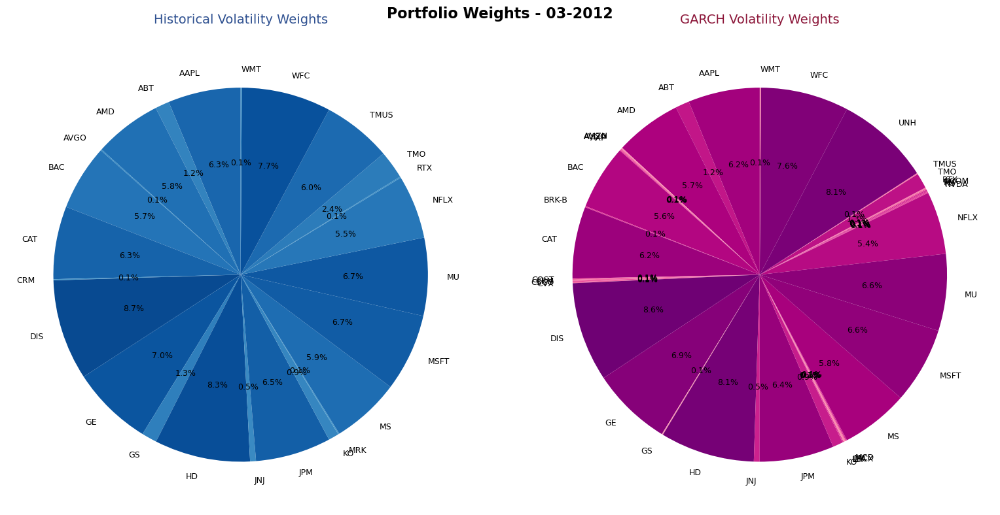

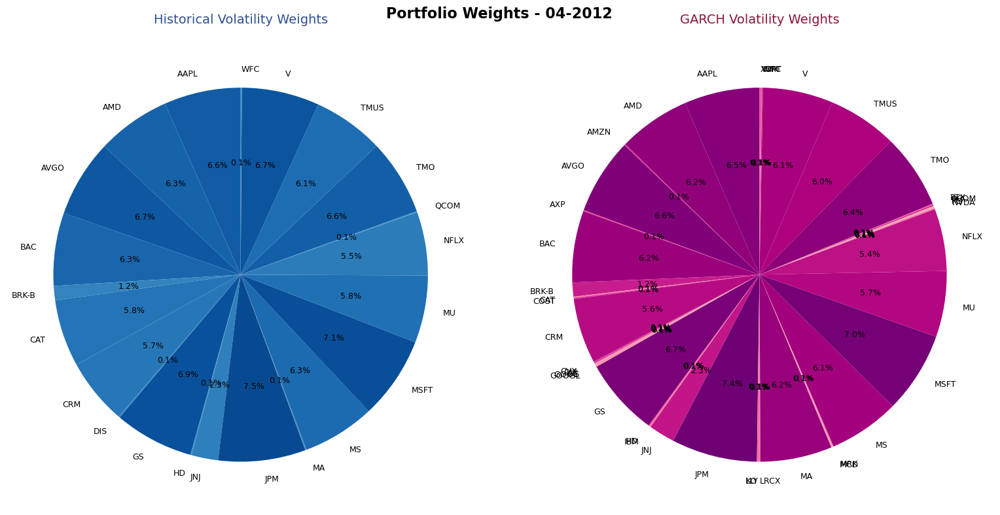

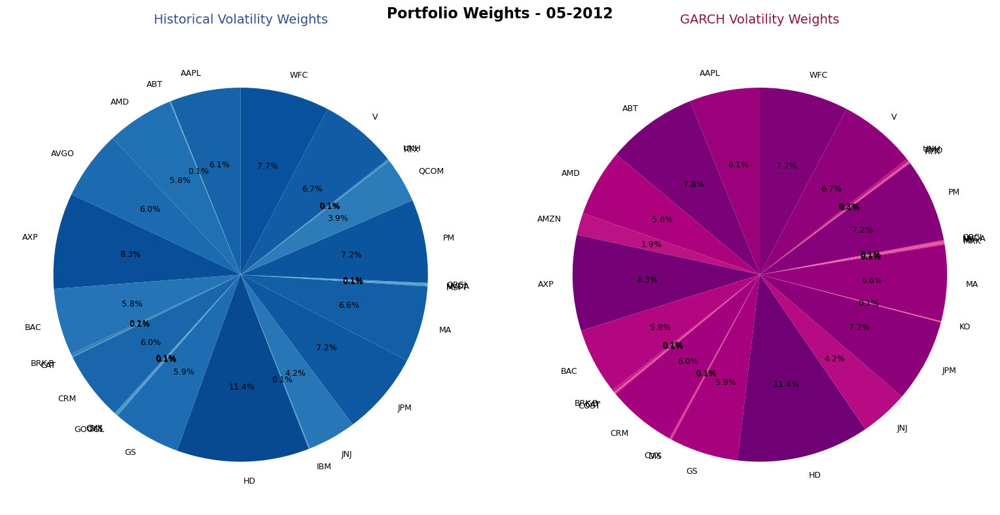

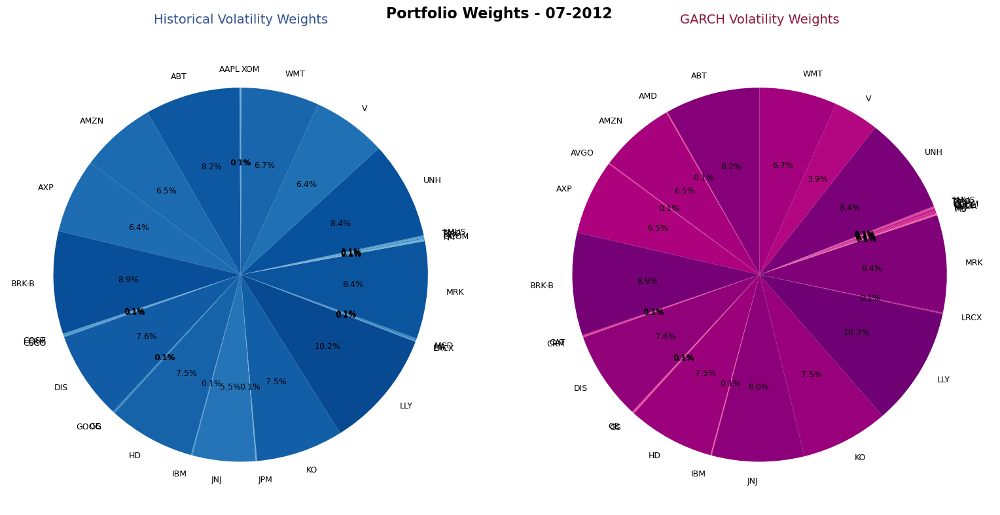

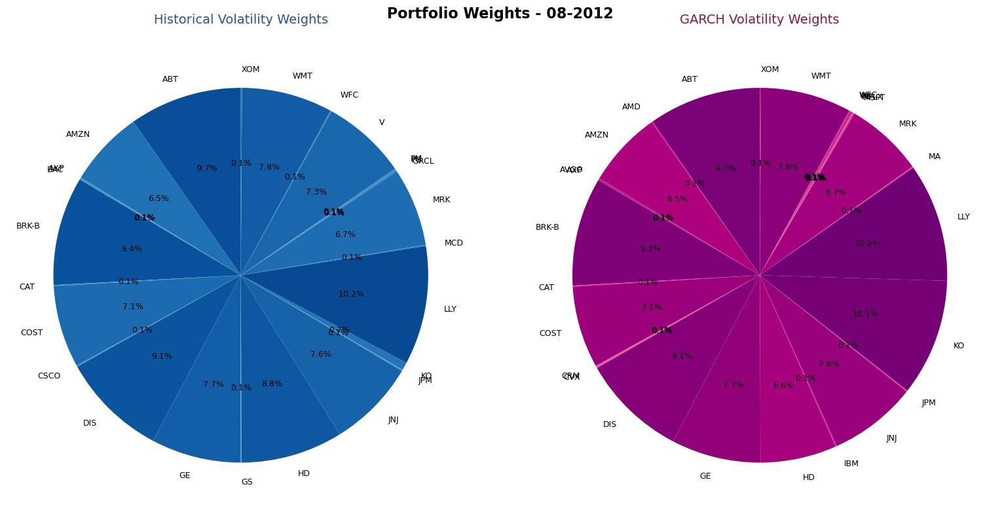

...

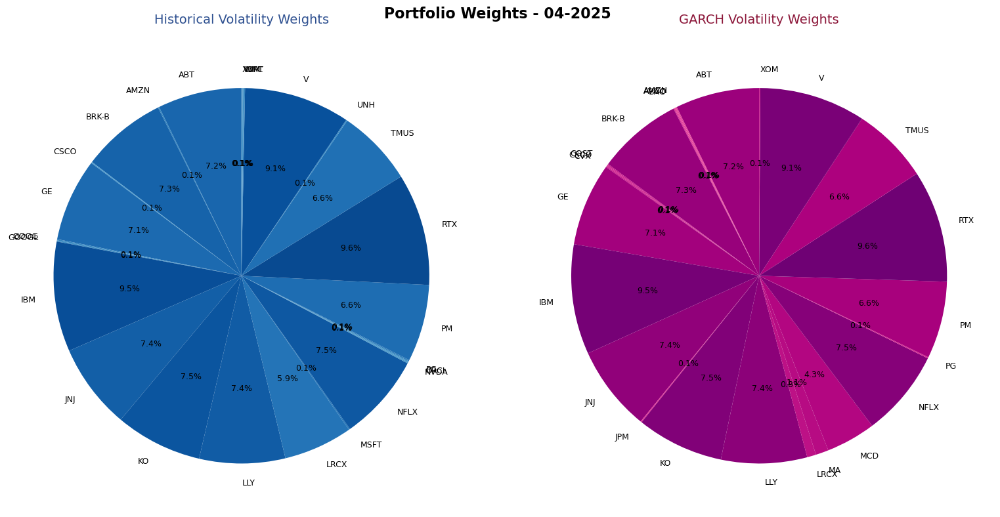

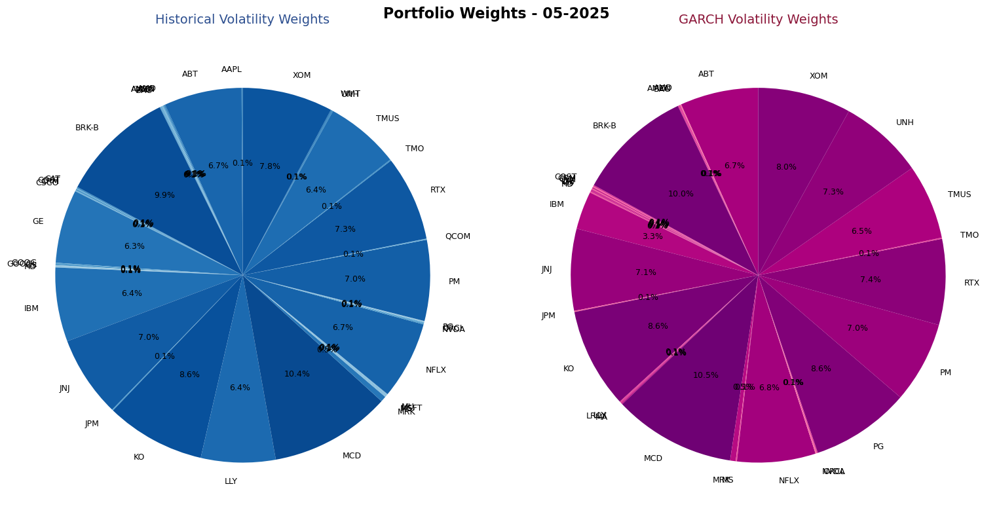

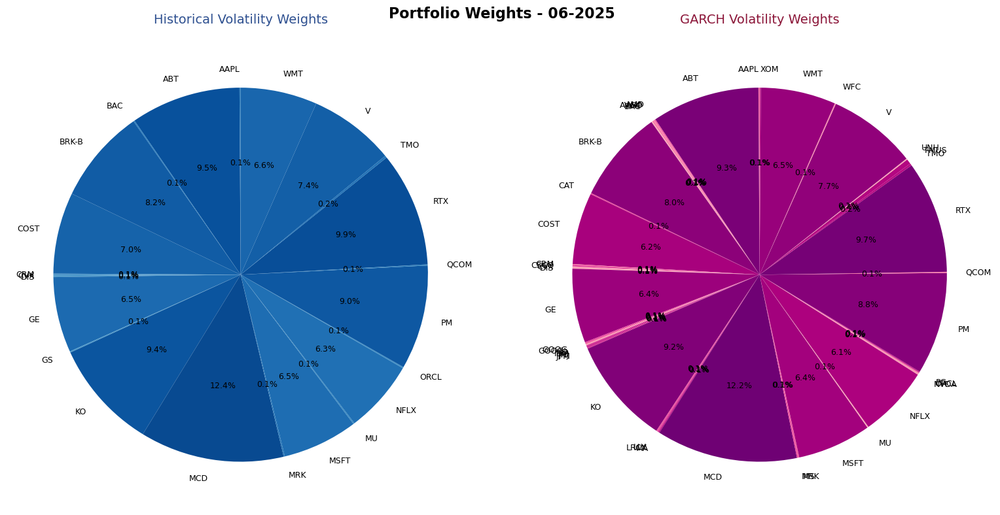

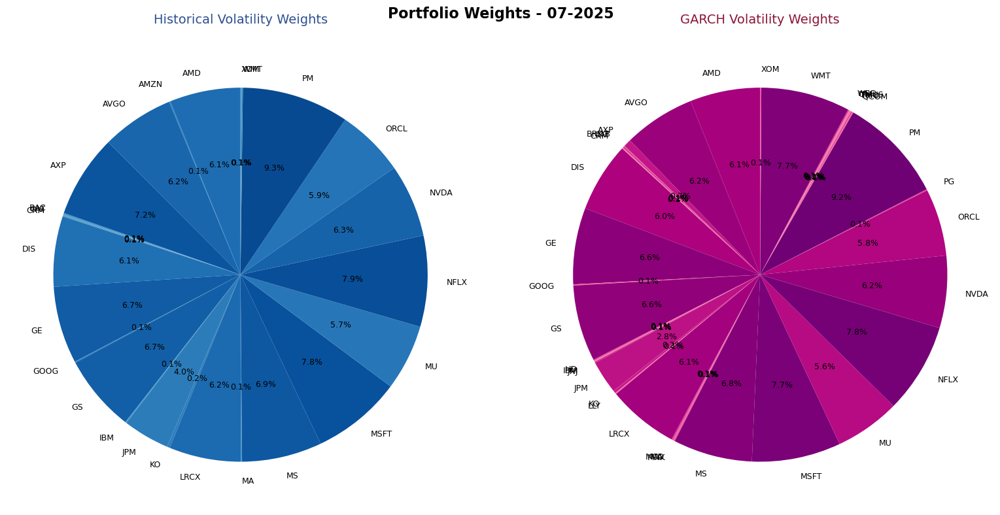

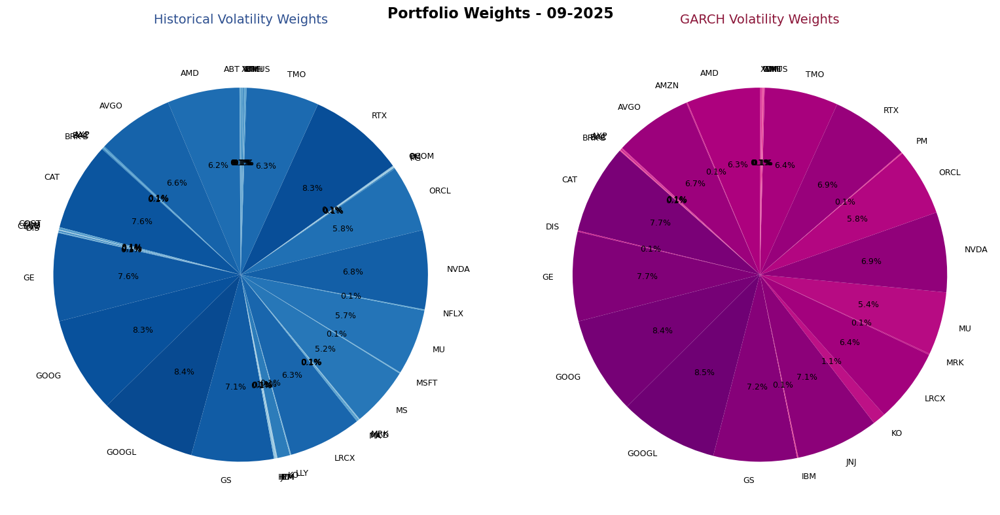

Generated 109 pie chart pairs


In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

# Load data
gw = pd.read_excel("all_data/weights_garch.xlsx")
hw = pd.read_excel("all_data/weights_hist.xlsx")

# Stock columns (excluding Date)
stocks = ['AAPL', 'ABT', 'AMD', 'AMZN', 'AVGO', 'AXP', 'BAC', 'BRK-B',
          'CAT', 'COST', 'CRM', 'CSCO', 'CVX', 'DIS', 'GE', 'GOOG', 'GOOGL', 'GS',
          'HD', 'IBM', 'JNJ', 'JPM', 'KO', 'LLY', 'LRCX', 'MA', 'MCD', 'MRK',
          'MS', 'MSFT', 'MU', 'NFLX', 'NVDA', 'ORCL', 'PG', 'PM', 'QCOM', 'RTX',
          'TMO', 'TMUS', 'UNH', 'V', 'WFC', 'WMT', 'XOM']

# Create color palettes
blues = plt.cm.Blues(np.linspace(0.9, 0.3, len(stocks)))
maroons = plt.cm.RdPu(np.linspace(0.9, 0.3, len(stocks)))

# Loop through each month
for idx in range(len(hw)):
    month_date = hw.loc[idx, 'Date']
    
    # Get weights for this month
    hw_weights = hw.loc[idx, stocks].values
    gw_weights = gw.loc[idx, stocks].values
    
    # Sort indices by weight (descending) for color assignment
    hw_sorted_idx = np.argsort(hw_weights)[::-1]
    gw_sorted_idx = np.argsort(gw_weights)[::-1]
    
    # Assign colors based on weight ranking
    hw_colors = np.zeros((len(stocks), 4))
    gw_colors = np.zeros((len(stocks), 4))
    
    for rank, stock_idx in enumerate(hw_sorted_idx):
        hw_colors[stock_idx] = blues[rank]
    
    for rank, stock_idx in enumerate(gw_sorted_idx):
        gw_colors[stock_idx] = maroons[rank]
    
    # Filter out zero weights for cleaner display
    hw_mask = hw_weights > 0.001
    gw_mask = gw_weights > 0.001
    
    # Create figure
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
    fig.suptitle(f'Portfolio Weights - {month_date}', fontsize=16, fontweight='bold')
    
    # Historical Volatility Pie
    ax1.pie(hw_weights[hw_mask], 
            labels=np.array(stocks)[hw_mask],
            colors=hw_colors[hw_mask],
            autopct='%1.1f%%',
            startangle=90,
            textprops={'fontsize': 9})
    ax1.set_title('Historical Volatility Weights', fontsize=14, pad=20, color='#2E5090')
    
    # GARCH Pie
    ax2.pie(gw_weights[gw_mask],
            labels=np.array(stocks)[gw_mask],
            colors=gw_colors[gw_mask],
            autopct='%1.1f%%',
            startangle=90,
            textprops={'fontsize': 9})
    ax2.set_title('GARCH Volatility Weights', fontsize=14, pad=20, color='#8B1538')
    
    plt.tight_layout()
    plt.show()
    plt.close()

print(f"Generated {len(hw)} pie chart pairs")